# Nairobi Road Crash Prediction & Hotspot Detection 

## Business Understanding

Road traffic crashes represent a critical public health crisis in Kenya, with profound social and economic implications:
- Leading cause of death for young adults in Kenya.
- 12th most common cause of death across all age groups
- Kenya's road traffic fatality rate of 28 deaths per 100,000 people mirrors the broader sub-Saharan African crisis (27 per 100,000).
- 92% of crash fatalities occur in low- and middle-income countries like Kenya.
- Tragic incidents like the April 1, 2024 five-vehicle crash on Nairobi-Mombasa highway (11 deaths, 7 from one family) highlight the devastating human cost.

Nairobi faces frequent road traffic accidents resulting in injuries, deaths, and economic losses. Current road safety measures are mostly reactive and lack predictive insights. This project uses machine learning and geospatial clustering to predict crash severity and detect accident hotspots, helping stakeholders like NTSA and urban planners take proactive, data-driven safety actions.

## Problem Statement

There is no existing predictive system in Nairobi to determine the likelihood or severity of road crashes, making it hard for authorities to target interventions. The primary goal of the  project is to  address this gap by building a machine learning–powered web app that forecasts crash severity and visualizes high-risk zones based on historical crash data.
This will enable Kenyan authorities to:
- Forecast crash severity in different locations.
- Visualize high-risk zones for targeted interventions
- Optimize resource allocation by focusing on the most dangerous roads
- Enable proactive safety measures rather than reactive responses

##### Expected Impact:
- Reduce road traffic fatalities and injuries through data-driven interventions
- Maximize return on investment for road safety initiatives
- Support evidence-based policy making for transport authorities
- Contribute to achieving reduced road traffic fatalities 

## Objectives

The project aims to answer the following questions:
1. What  are the high-risk crash hotspots across the city, based on location and time patterns?
2. What is the crash severity based on day, hour, and other contextual features?
3. Build an interactive web app that allows users to input a date and time and receive high-risk location predictions and safety recommendations.

## Overview
 1. Data Loading & Preprocessing
 2. Feature Engineering
 3. Exploratory Data Analysis 
 4. Model Development (3 Different Models)
 5. Model Evaluation & Comparison
 6. Best Model Selection for Deployment
 7. Model Saving for deployment


## Data Understanding

The primary data source for this analysis is the popular Kenyan Twitter account @Ma3Route, which has over 1.4 million followers and serves as a crowdsourced platform where users actively share real-time information about transport and traffic conditions.
The dataset spans an 11-year period from August 2012 to July 2023 and includes over one million raw posts queried from the platform.

Through processing, 31,064 individual crash incidents were identified, with the majority of reports originating from Nairobi and its surrounding areas. To better analyze spatial patterns, crashes were grouped into 500-meter clusters using Ward’s hierarchical algorithm.

Crashes were geolocated using algorithmic extraction of road and landmark references, with 65% recall and 81% precision. The dataset highlights high-risk zones through spatial clustering, offering a valuable tool for targeted road safety interventions.

### Importing necessary Libraries 

First we will install and import the necessary libraries required for the project.

In [1]:
# Install required packages
!pip install folium geopy xgboost -q

^C


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import folium
from folium.plugins import HeatMap
from geopy.distance import great_circle

# Machine Learning Libraries
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.cluster import DBSCAN
from sklearn.metrics import (classification_report, confusion_matrix, accuracy_score, 
                           roc_auc_score, f1_score, precision_recall_fscore_support)

# Advanced ML
from xgboost import XGBClassifier

# Utilities
import joblib
import warnings
warnings.filterwarnings('ignore')


### 1. Data Loading and Preprocessing

Next, we load the Nairobi road crash dataset and perform an initial exploration to understand the structure, quality, and scope of our data


In [ ]:
# Load the dataset
df = pd.read_excel('nairobi-road-crashes-data_public-copy.xlsx',sheet_name='ma3route_crashes_algorithmcode')

In [ ]:
# Display first five rows
df.head()

,crash_id,crash_datetime,crash_date,latitude,longitude,n_crash_reports,contains_fatality_words,contains_pedestrian_words,contains_matatu_words,contains_motorcycle_words
0,1,2018-06-06 20:39:54,2018-06-06,-1.263030,36.764374,1,0,0,0,0
1,2,2018-08-17 06:15:54,2018-08-17,-0.829710,37.037820,1,1,0,0,0
2,3,2018-05-25 17:51:54,2018-05-25,-1.125301,37.003297,1,0,0,0,0
3,4,2018-05-25 18:11:54,2018-05-25,-1.740958,37.129026,1,0,0,0,0
4,5,2018-05-25 21:59:54,2018-05-25,-1.259392,36.842321,1,1,0,0,0


In [ ]:
#dataset shape
df.shape

(31064, 10)

In [ ]:
#data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31064 entries, 0 to 31063
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   crash_id                   31064 non-null  int64         
 1   crash_datetime             31064 non-null  datetime64[ns]
 2   crash_date                 31064 non-null  datetime64[ns]
 3   latitude                   31064 non-null  float64       
 4   longitude                  31064 non-null  float64       
 5   n_crash_reports            31064 non-null  int64         
 6   contains_fatality_words    31064 non-null  int64         
 7   contains_pedestrian_words  31064 non-null  int64         
 8   contains_matatu_words      31064 non-null  int64         
 9   contains_motorcycle_words  31064 non-null  int64         
dtypes: datetime64[ns](2), float64(2), int64(6)
memory usage: 2.4 MB


In [ ]:
#summary statistics
df.describe()


,crash_id,crash_datetime,crash_date,latitude,longitude,n_crash_reports,contains_fatality_words,contains_pedestrian_words,contains_matatu_words,contains_motorcycle_words
count,31064.000000,31064,31064,31064.000000,31064.000000,31064.000000,31064.000000,31064.000000,31064.000000,31064.000000
mean,15532.500000,2017-07-01 01:41:02.041301760,2017-06-30 12:14:52.814833920,-1.272481,36.852499,1.400914,0.073526,0.030389,0.081799,0.036763
min,1.000000,2012-08-08 08:35:06,2012-08-08 00:00:00,-3.100000,36.283950,1.000000,0.000000,0.000000,0.000000,0.000000
25%,7766.750000,2015-05-04 14:55:03.249999872,2015-05-04 00:00:00,-1.316142,36.798093,1.000000,0.000000,0.000000,0.000000,0.000000
50%,15532.500000,2016-11-05 08:03:37,2016-11-05 00:00:00,-1.281033,36.840281,1.000000,0.000000,0.000000,0.000000,0.000000
75%,23298.250000,2019-06-28 08:24:29.500000,2019-06-28 00:00:00,-1.244783,36.891427,1.000000,0.000000,0.000000,0.000000,0.000000
max,31064.000000,2023-07-12 20:30:57,2023-07-12 00:00:00,-0.565402,37.879490,66.000000,1.000000,1.000000,1.000000,1.000000
std,8967.548717,NaN,NaN,0.118961,0.113650,1.486540,0.261002,0.171658,0.274062,0.188182


In [ ]:
# Checking date range
if 'crash_date' in df.columns:
    print(f"\nTIME PERIOD COVERAGE:")
    print(f"From: {df['crash_date'].min()}")
    print(f"To: {df['crash_date'].max()}")
    print(f"Duration: {(pd.to_datetime(df['crash_date'].max()) - pd.to_datetime(df['crash_date'].min())).days} days")



TIME PERIOD COVERAGE:
From: 2012-08-08 00:00:00
To: 2023-07-12 00:00:00
Duration: 3990 days


####  Data Preprocessing 

lets check the data for missing values, duplicates, and coordinate validation for geographic analysis

In [ ]:
# Check for missing values
df.isnull().sum()

crash_id                     0
crash_datetime               0
crash_date                   0
latitude                     0
longitude                    0
n_crash_reports              0
contains_fatality_words      0
contains_pedestrian_words    0
contains_matatu_words        0
contains_motorcycle_words    0
dtype: int64

No missing values found

In [ ]:
# Check for duplicates
duplicates = df.duplicated().sum()
print(f"\nDataset Duplicates:")
print(f"Number of duplicate rows: {duplicates}")
if duplicates > 0:
    print(f"Percentage of duplicates: {(duplicates/len(df))*100:.2f}%")



Dataset Duplicates:
Number of duplicate rows: 0


In [ ]:
# Geographic coordinates validation
print(f"\nGeographic Coordinates Validation:")
if 'latitude' in df.columns and 'longitude' in df.columns:
    print(f"Latitude range: {df['latitude'].min():.6f} to {df['latitude'].max():.6f}")
    print(f"Longitude range: {df['longitude'].min():.6f} to {df['longitude'].max():.6f}")


Geographic Coordinates Validation:
Latitude range: -3.100000 to -0.565402
Longitude range: 36.283950 to 37.879490


In [ ]:
# Check for valid Nairobi coordinates (approximate bounds)
valid_coords = df[
    (df['latitude'].between(-1.5, -1.0)) & 
    (df['longitude'].between(36.5, 37.2))
]
print(f"Records with valid Nairobi coordinates: {len(valid_coords):,} ({len(valid_coords)/len(df)*100:.1f}%)")


Records with valid Nairobi coordinates: 29,733 (95.7%)


In [ ]:
# Check for missing coordinates
missing_coords = df[['latitude', 'longitude']].isnull().any(axis=1).sum()
print(f"Records with missing coordinates: {missing_coords}")


Records with missing coordinates: 0


### 2. Feature Engineering

Let's Create meaningful features from raw data that will enhance our model'sability to predict crash severity and identify patterns

In [ ]:
# Converting datetime columns
df['crash_datetime'] = pd.to_datetime(df['crash_datetime'])
df['crash_date'] = pd.to_datetime(df['crash_date']).dt.date

In [ ]:
# Extracting time_based features
df['crash_hour'] = df['crash_datetime'].dt.hour
df['crash_dayofweek'] = df['crash_datetime'].dt.dayofweek
df['crash_month'] = df['crash_datetime'].dt.month
df['crash_day'] = df['crash_datetime'].dt.day

In [ ]:
# Creating binary target variables/indicators for different crash types
df['fatal_crash'] = df['contains_fatality_words'].astype(int)
df['pedestrian_involved'] = df['contains_pedestrian_words'].astype(int)
df['matatu_involved'] = df['contains_matatu_words'].astype(int)
df['motorcycle_involved'] = df['contains_motorcycle_words'].astype(int)

In [ ]:
# Creating additional risk_based time features
df['rush_hour'] = df['crash_hour'].apply(lambda x: 1 if (7 <= x <= 9) or (16 <= x <= 19) else 0)
df['weekend'] = df['crash_dayofweek'].apply(lambda x: 1 if x >= 5 else 0)
df['night_time'] = df['crash_hour'].apply(lambda x: 1 if x >= 22 or x <= 5 else 0)

In [ ]:
# Creating severity score (our main target)/scoring system
df['severity_score'] = (df['fatal_crash'] * 3 + 
                       df['pedestrian_involved'] * 2 + 
                       df['matatu_involved'] * 1.5 + 
                       df['motorcycle_involved'] * 1.2)

In [ ]:
# Categorizing severity into interpretable groups
df['severity_category'] = pd.cut(df['severity_score'], 
                                bins=[-0.1, 0, 1, 2, 10], 
                                labels=['No_Injury', 'Minor', 'Moderate', 'Severe'])

In [ ]:
# Creating combined crash type feature for analysis
df['crash_type'] = 'other'
df.loc[df['fatal_crash'] == 1, 'crash_type'] = 'fatal'
df.loc[df['pedestrian_involved'] == 1, 'crash_type'] = 'pedestrian'
df.loc[df['matatu_involved'] == 1, 'crash_type'] = 'matatu'
df.loc[df['motorcycle_involved'] == 1, 'crash_type'] = 'motorcycle'

In [ ]:
# Prioritize fatal crashes in combined categories
df.loc[(df['fatal_crash'] == 1) & (df['pedestrian_involved'] == 1), 'crash_type'] = 'fatal_pedestrian'

In [ ]:
print(f"Severity categories: {df['severity_category'].value_counts().to_dict()}")

Severity categories: {'No_Injury': 25059, 'Moderate': 3550, 'Severe': 2455, 'Minor': 0}


### 3. Exploratory Data Analysis (EDA)

Lets conduct a comprehensive visual analysis to understand crash patterns, temporal trends,
and geographic distributions that will inform our modeling strategy.


In [ ]:
# plotting style
plt.style.use('seaborn-v0_8')
fig_size = (12, 8)

#### Crash Severity Distribution Analysis

Severity distribution:
severity_category
No_Injury    25059
Moderate      3550
Severe        2455
Minor            0
Name: count, dtype: int64
Percentage distribution:
  No_Injury: 25,059 (80.7%)
  Moderate: 3,550 (11.4%)
  Severe: 2,455 (7.9%)
  Minor: 0 (0.0%)


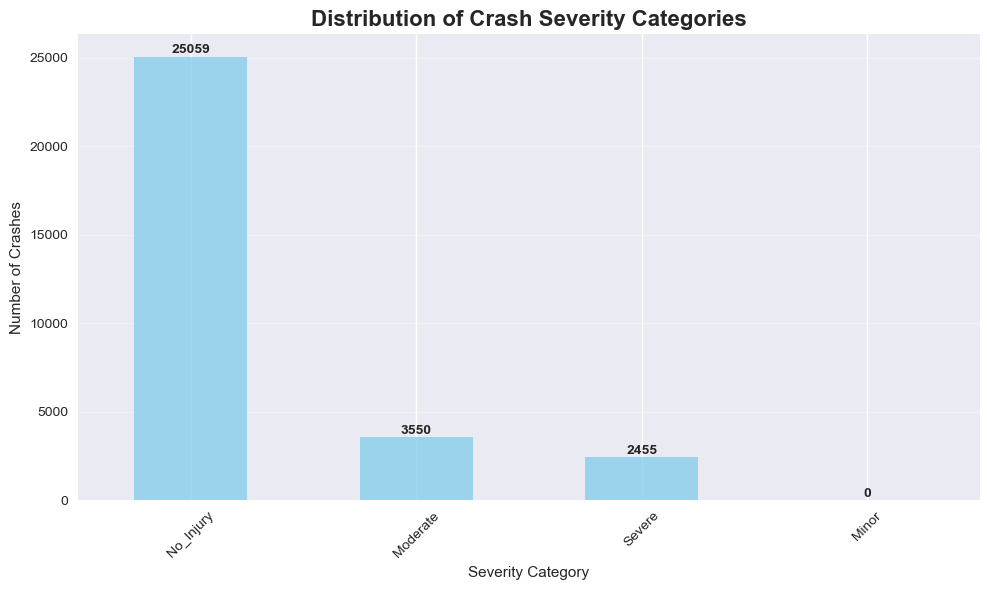

In [ ]:
# Severity Distribution
severity_counts = df['severity_category'].value_counts()
print(f"Severity distribution:\n{severity_counts}")
print(f"Percentage distribution:")
for category, count in severity_counts.items():
    print(f"  {category}: {count:,} ({count/len(df)*100:.1f}%)")

plt.figure(figsize=(10, 6))
severity_counts.plot(kind='bar', color='skyblue', alpha=0.8)
plt.title('Distribution of Crash Severity Categories', fontsize=16, fontweight='bold')
plt.xlabel('Severity Category')
plt.ylabel('Number of Crashes')
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.3)
for i, v in enumerate(severity_counts.values):
    plt.text(i, v + 10, str(v), ha='center', va='bottom', fontweight='bold')
plt.tight_layout()
plt.show()


##### Daily Crash trends

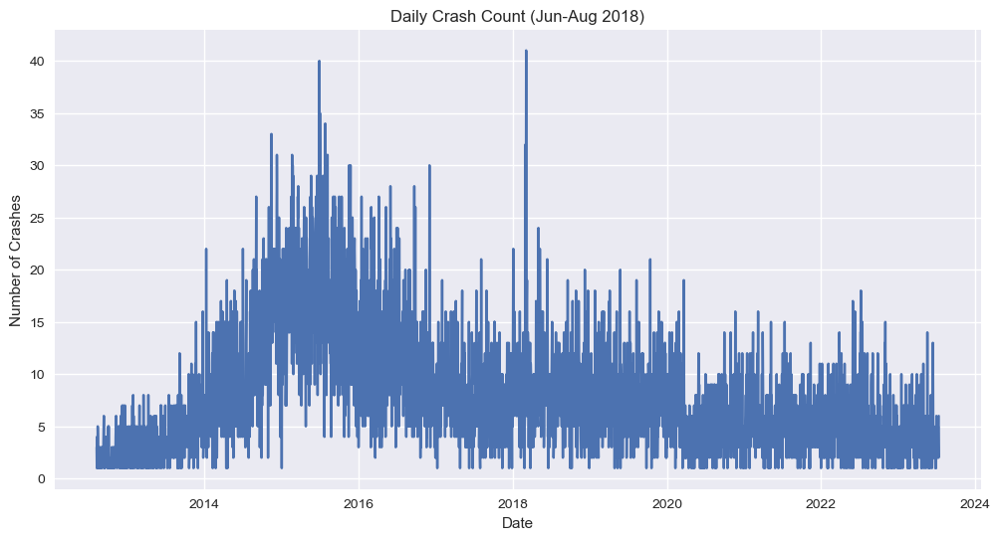

In [ ]:
# Daily crash trends over time
plt.figure(figsize=(12, 6))
df['crash_date'].value_counts().sort_index().plot()
plt.title('Daily Crash Count (Jun-Aug 2018)')
plt.xlabel('Date')
plt.ylabel('Number of Crashes')
plt.grid(True)
plt.show()

-The number of reported crashes increased steadily until mid-2015, after which they began to decline.

-This decrease in reports after 2015 may reflect reduced use of @Ma3Route rather than an actual drop in crash occurrences. Similarly, in March 2020, a sharp decline in reported crashes coincided with the introduction of social distancing measures and a curfew in response to COVID-19.

-While this reduction may indicate fewer crashes—an effect observed in other settings—it could also be attributed to fewer people on the roads to report incidents. 

##### Hourly Crash Distribution

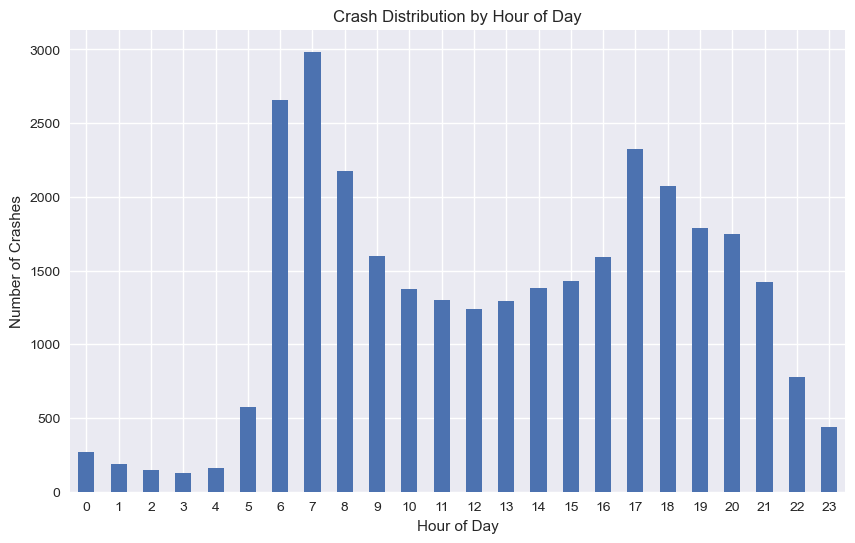

In [ ]:
# Hourly crash distribution
plt.figure(figsize=(10, 6))
df['crash_hour'].value_counts().sort_index().plot(kind='bar')
plt.title('Crash Distribution by Hour of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Crashes')
plt.xticks(rotation=0)
plt.show()

Crash Patterns by Time of Day

Highest Crash Frequency:
The peak in crashes occurs between 6:00 AM and 8:00 AM, with 7:00 AM having the highest number (~3000 crashes). This time likely reflects morning rush hour, when many commuters are on the road heading to work or school.

Secondary Peak (Evening):
Another noticeable rise is observed between 4:00 PM and 7:00 PM (16:00–19:00), peaking at 5:00 PM (17:00). This aligns with evening rush hour, when people are returning home from work or school, and road congestion is high.

Lowest Crash Frequency:
Crash numbers are lowest during late night to early morning hours (00:00–05:00). This is likely due to reduced traffic volume at night.

Gradual Daily Trend:
There’s a sharp rise from 5:00 AM to 7:00 AM, indicating the start of daily activity. After the morning peak, there's a mid-day dip, followed by a steady climb into the evening, then a gradual drop after 8:00 PM.



#####  Day of week distribution

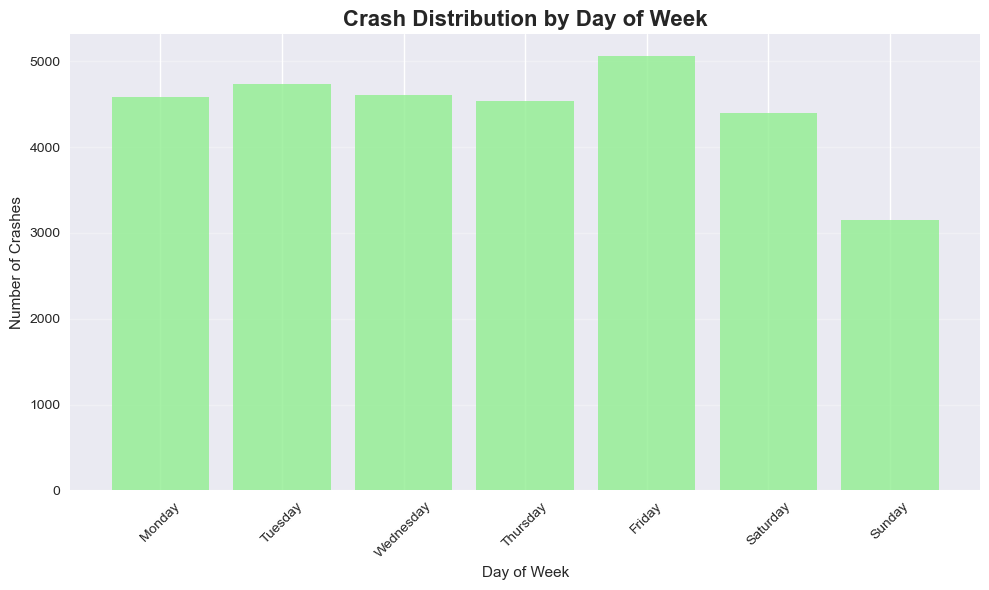

In [ ]:
# Weekly pattern analysis
weekday_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
plt.figure(figsize=(10, 6))
weekly_crashes = df['crash_dayofweek'].value_counts().sort_index()
plt.bar(range(7), weekly_crashes.values, color='lightgreen', alpha=0.8)
plt.title('Crash Distribution by Day of Week', fontsize=16, fontweight='bold')
plt.xlabel('Day of Week')
plt.ylabel('Number of Crashes')
plt.xticks(range(7), weekday_names, rotation=45)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()


Crash patterns by day of the week show that **Friday experiences the highest number of crashes**, likely due to increased traffic as people wrap up the workweek, begin social activities, or drive while fatigued. **Monday through Thursday** also record consistently high crash numbers, reflecting typical commuter and school-related traffic. In contrast, there’s a **noticeable decline over the weekend**, with **Saturday seeing fewer crashes** due to reduced work travel, and **Sunday recording the lowest**, possibly because of lighter traffic, limited movement, and more relaxed driving behavior.


##### Hourly patterns by crash severity

<Figure size 1200x800 with 0 Axes>

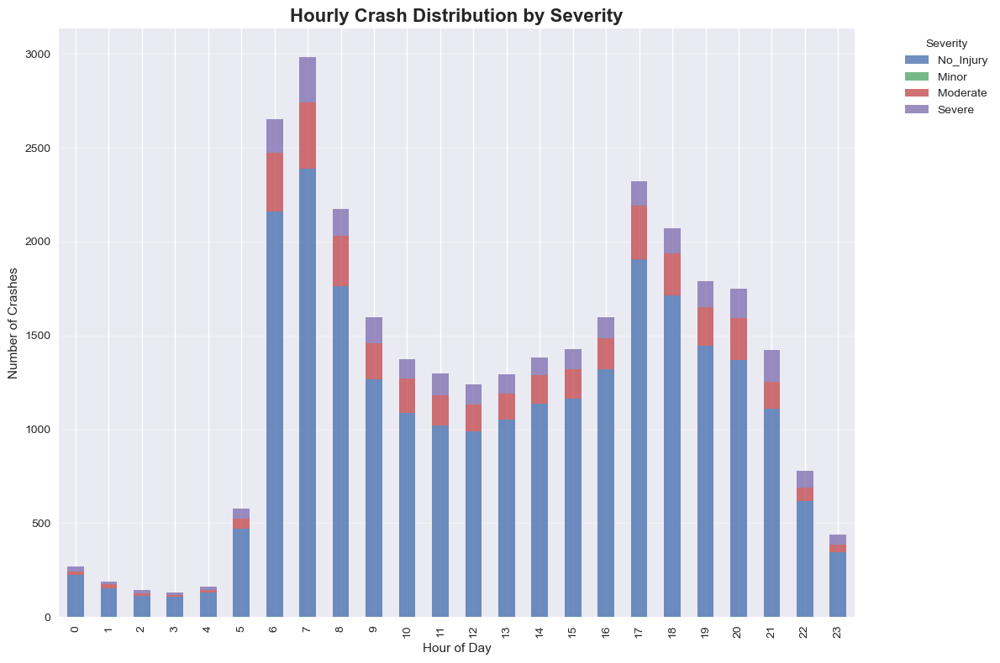

In [ ]:
# Hourly patterns by crash severity
plt.figure(figsize=fig_size)
severity_hourly = df.groupby(['crash_hour', 'severity_category']).size().unstack(fill_value=0)
severity_hourly.plot(kind='bar', stacked=True, figsize=fig_size, alpha=0.8)
plt.title('Hourly Crash Distribution by Severity', fontsize=16, fontweight='bold')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Crashes')
plt.legend(title='Severity', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()


We clearly see that crashes of all severities peak during morning (6–8 AM) and evening (4–7 PM) hours, aligned with commuting periods. While No_Injury crashes are most common, Severe and Moderate crashes are more frequent during early morning and late evening, possibly due to riskier driving conditions. The lowest crash volumes occur overnight, but with a relatively higher risk of severe outcomes.

##### Crash type patterns throughout the day

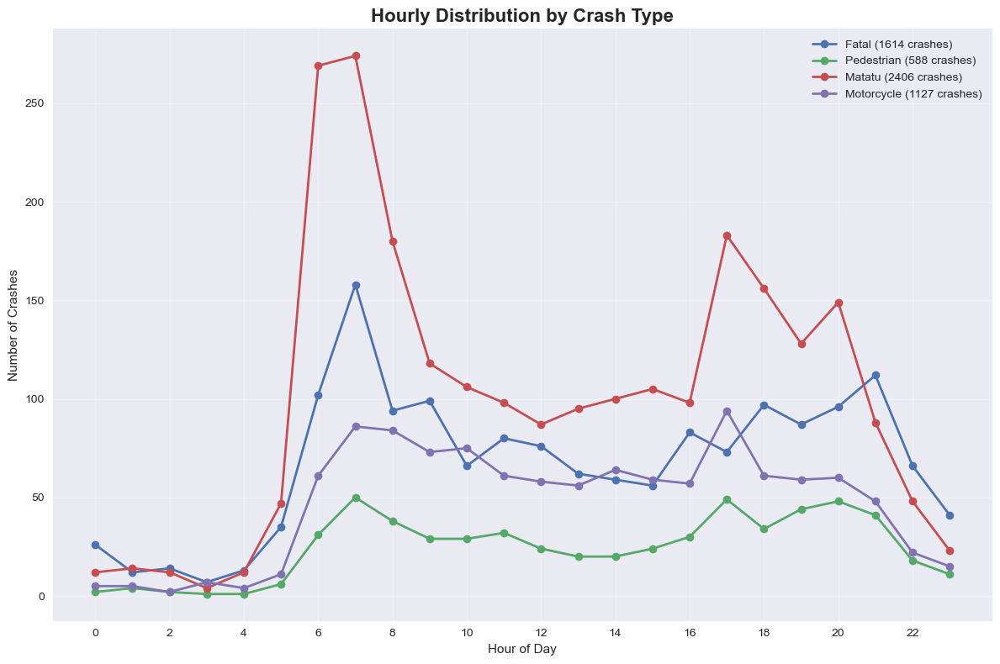

In [ ]:
# Crash type patterns throughout the day
plt.figure(figsize=fig_size)
crash_types = ['fatal', 'pedestrian', 'matatu', 'motorcycle']
for crash_type in crash_types:
    subset = df[df['crash_type'] == crash_type]
    if len(subset) > 10:  # Only plot types with sufficient data
        hourly_dist = subset['crash_hour'].value_counts().sort_index()
        plt.plot(hourly_dist.index, hourly_dist.values, marker='o', 
                label=f'{crash_type.title()} ({len(subset)} crashes)', linewidth=2)

plt.title('Hourly Distribution by Crash Type', fontsize=16, fontweight='bold')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Crashes')
plt.legend()
plt.grid(True, alpha=0.3)
plt.xticks(range(0, 24, 2))
plt.tight_layout()
plt.show()


The chart shows that crashes for all types (Fatal, Pedestrian, Matatu, and Motorcycle) peak during morning (6–9 AM) and evening (4–7 PM) rush hours, coinciding with high traffic volumes. Fatal and Pedestrian crashes are more frequent in low-light conditions (early morning and late evening), likely due to reduced visibility and riskier behavior. Motorcycle and Matatu crashes also spike during commuting times but remain elevated into the night, possibly linked to commercial activity. Overnight hours (12–5 AM) see fewer crashes overall but a higher proportion of severe outcomes, suggesting factors like fatigue or impaired driving. The data underscores the need for targeted safety interventions during high-risk periods.

##### Weekly patterns by crash type

<Figure size 1200x800 with 0 Axes>

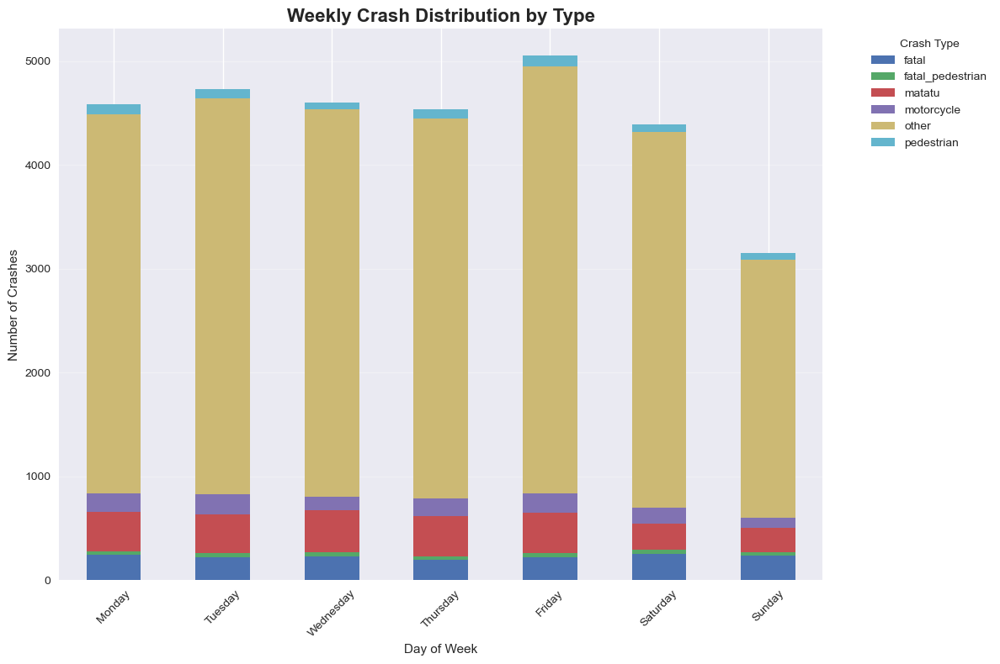

In [ ]:
# Weekly patterns by crash type
plt.figure(figsize=fig_size)
weekly_by_type = df.groupby(['crash_dayofweek', 'crash_type']).size().unstack(fill_value=0)
weekly_by_type.plot(kind='bar', stacked=True, figsize=fig_size)
plt.title('Weekly Crash Distribution by Type', fontsize=16, fontweight='bold')
plt.xlabel('Day of Week')
plt.ylabel('Number of Crashes')
plt.xticks(range(7), weekday_names, rotation=45)
plt.legend(title='Crash Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

**Pedestrian crashes peak midweek** (Wednesday–Friday), likely due to higher foot traffic, while **Matatu and motorcycle crashes rise toward the weekend**, possibly linked to increased commercial and leisure travel. **Weekends see fewer pedestrian incidents but sustained motor vehicle crashes**, suggesting different risk patterns. Overall, crash volumes are highest midweek, emphasizing the need for targeted safety measures like pedestrian protections on workdays and traffic enforcement on weekends.

#### Geographic Analysis and Hotspot Identification

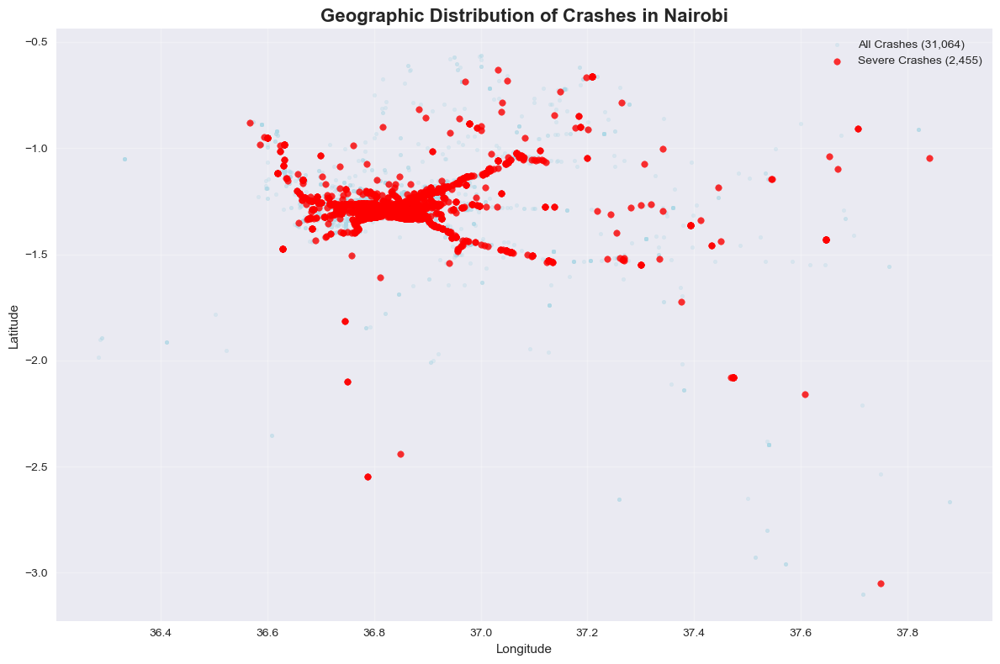

In [ ]:
# Basic geographic distribution
plt.figure(figsize=fig_size)
severe_crashes = df[df['severity_category'] == 'Severe']
plt.scatter(df['longitude'], df['latitude'], alpha=0.3, s=10, 
           label=f'All Crashes ({len(df):,})', color='lightblue')
plt.scatter(severe_crashes['longitude'], severe_crashes['latitude'], 
           alpha=0.8, s=30, label=f'Severe Crashes ({len(severe_crashes):,})', color='red')
plt.title('Geographic Distribution of Crashes in Nairobi', fontsize=16, fontweight='bold')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

Severe crashes appear clustered in specific areas, suggesting geographic hotspots that could be targeted for safety interventions.


##### Creating a base map centered on Nairobi

In [ ]:
# Create interactive heatmap using Folium
nairobi_coords = [-1.286389, 36.817222]  # Approximate center of Nairobi
m = folium.Map(location=nairobi_coords, zoom_start=12)

# Add heatmap layer
heat_data = [[row['latitude'], row['longitude']] for index, row in df.iterrows() 
             if pd.notna(row['latitude']) and pd.notna(row['longitude'])]
HeatMap(heat_data, radius=15, blur=10, max_zoom=1).add_to(m)

# Save and display the map
m.save('crash_heatmap.html')
print(f"Interactive heatmap saved as 'crash_heatmap.html'")
print(f"Heatmap contains {len(heat_data):,} crash locations")
display(m)

# Identify top crash locations
print("\n Top Crash Locations:")
top_locations = df.groupby(['latitude', 'longitude']).size().sort_values(ascending=False).head(10)
print("Top 10 crash hotspots:")
for i, ((lat, lon), count) in enumerate(top_locations.items(), 1):
    print(f"  {i}. Location ({lat:.6f}, {lon:.6f}): {count} crashes")


Interactive heatmap saved as 'crash_heatmap.html'
Heatmap contains 31,064 crash locations



 Top Crash Locations:
Top 10 crash hotspots:
  1. Location (-1.267441, 36.835518): 201 crashes
  2. Location (-1.259367, 36.843123): 149 crashes
  3. Location (-1.331398, 36.888555): 136 crashes
  4. Location (-1.218637, 36.891361): 129 crashes
  5. Location (-1.203744, 36.917527): 122 crashes
  6. Location (-1.329937, 36.871007): 115 crashes
  7. Location (-1.259975, 36.843418): 113 crashes
  8. Location (-1.395628, 36.941025): 104 crashes
  9. Location (-1.274934, 36.823417): 102 crashes
  10. Location (-1.300013, 36.787803): 97 crashes


Based on the cordinates, the areas are:
- Around South B / Industrial Area
- Close to Ngara / Parklands
- Near Imara Daima / Mukuru area
- Eastleigh / Mathare area
- Muthaiga / Runda region
- Around Pipeline / Mukuru kwa Njenga
- Near Ngara again
- Close to Ruiru bypass / Eastern outskirts
- Westlands / Lavington area
- Karen / Lang’ata region

- This represents the areas that are prone to road accidents in Nairobi.


#### Advanced Clustering Analysis for Hotspot Detection

Lets use DBSCAN( Density-Based Spatial Clustering of Applications with Noise) clustering algorithm to detect crash hotspots in Nairobi based on geographic coordinates, then visualize the identified clusters on an interactive Folium map, highlighting crash severity and cluster centers.

In [ ]:
# Advanced Clustering Analysis for Hotspot Detection
print(" ADVANCED CLUSTERING ANALYSIS FOR HOTSPOT DETECTION")

# Perform DBSCAN clustering to identify crash hotspots
coords = df[['latitude', 'longitude']].dropna().values
kms_per_radian = 6371.0088
epsilon = 0.5 / kms_per_radian  # 0.5 km cluster radius

print(f" Performing DBSCAN clustering...")
print(f"   - Cluster radius: 0.5 km")
print(f"   - Minimum samples per cluster: 5")

# Perform DBSCAN clustering
db = DBSCAN(eps=epsilon, min_samples=5, algorithm='ball_tree', metric='haversine').fit(np.radians(coords))

# Add cluster labels to dataframe (only for rows with valid coordinates)
df_with_coords = df.dropna(subset=['latitude', 'longitude']).copy()
df_with_coords['cluster'] = db.labels_

# Calculate clustering results
n_clusters = len(set(db.labels_)) - (1 if -1 in db.labels_ else 0)
n_noise = list(db.labels_).count(-1)

print(f" Clustering completed!")
print(f"   - Number of hotspots identified: {n_clusters}")
print(f"   - Crashes in hotspots: {len(df_with_coords[df_with_coords['cluster'] != -1]):,}")
print(f"   - Isolated crashes (noise): {n_noise:,}")

# Create hotspot visualization map
print(" Creating hotspot visualization...")
m_clusters = folium.Map(location=nairobi_coords, zoom_start=12)
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 
          'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 
          'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']

# Plot clustered points
for idx, row in df_with_coords.iterrows():
    if row['cluster'] != -1:  # Only plot clustered points
        color = colors[row['cluster'] % len(colors)]
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=5,
            color=color,
            fill=True,
            fillColor=color,
            popup=f"Hotspot {row['cluster']+1}"
        ).add_to(m_clusters)

# Add cluster centers with detailed information
cluster_info = []
for cluster_id in range(n_clusters):
    cluster_points = df_with_coords[df_with_coords['cluster'] == cluster_id]
    center_lat = cluster_points['latitude'].mean()
    center_lon = cluster_points['longitude'].mean()
    cluster_size = len(cluster_points)
    
    # Calculate severity distribution in cluster
    severity_dist = cluster_points['severity_category'].value_counts()
    
    cluster_info.append({
        'cluster_id': cluster_id,
        'center_lat': center_lat,
        'center_lon': center_lon,
        'crash_count': cluster_size,
        'severity_dist': severity_dist
    })
    
    # Add marker for cluster center
    popup_text = f"""
    <b>Hotspot {cluster_id+1}</b><br>
    Crashes: {cluster_size}<br>
    Severe: {severity_dist.get('Severe', 0)}<br>
    Moderate: {severity_dist.get('Moderate', 0)}<br>
    Minor: {severity_dist.get('Minor', 0)}
    """
    
    folium.Marker(
        location=[center_lat, center_lon],
        icon=folium.Icon(color=colors[cluster_id % len(colors)], icon='exclamation-sign'),
        popup=folium.Popup(popup_text, max_width=200)
    ).add_to(m_clusters)

m_clusters.save('crash_hotspots.html')
print(f" Hotspot map saved as 'crash_hotspots.html'")
display(m_clusters)

# Display cluster summary
print("\n HOTSPOT SUMMARY:")
cluster_df = pd.DataFrame(cluster_info)
cluster_df = cluster_df.sort_values('crash_count', ascending=False)
print(f"Top 5 most dangerous hotspots:")
for i, row in cluster_df.head().iterrows():
    print(f"  Hotspot {row['cluster_id']+1}: {row['crash_count']} crashes at ({row['center_lat']:.6f}, {row['center_lon']:.6f})")

 ADVANCED CLUSTERING ANALYSIS FOR HOTSPOT DETECTION
 Performing DBSCAN clustering...
   - Cluster radius: 0.5 km
   - Minimum samples per cluster: 5
 Clustering completed!
   - Number of hotspots identified: 195
   - Crashes in hotspots: 30,315
   - Isolated crashes (noise): 749
 Creating hotspot visualization...
 Hotspot map saved as 'crash_hotspots.html'



 HOTSPOT SUMMARY:
Top 5 most dangerous hotspots:
  Hotspot 1: 20463 crashes at (-1.284457, 36.830606)
  Hotspot 20: 622 crashes at (-1.204005, 36.917524)
  Hotspot 23: 519 crashes at (-1.187732, 36.931597)
  Hotspot 34: 478 crashes at (-1.155692, 36.959972)
  Hotspot 5: 459 crashes at (-1.370372, 36.918056)


#### Data Preparation For Machine Learning

Preparing features and target variables for model training. This critical step ensures our models receive clean, properly formatted data


In [ ]:
# comprehensive feature set for our models
feature_columns = ['crash_hour', 'crash_dayofweek', 'crash_month', 'latitude', 
                  'longitude', 'rush_hour', 'weekend', 'night_time']

In [ ]:
#printout of selected features
print(f" Selected Features ({len(feature_columns)}):")
for i, feature in enumerate(feature_columns, 1):
    print(f"  {i}. {feature}")

 Selected Features (8):
  1. crash_hour
  2. crash_dayofweek
  3. crash_month
  4. latitude
  5. longitude
  6. rush_hour
  7. weekend
  8. night_time


##### Split data into features (X) and target (y)

In [ ]:
X = df[feature_columns].copy()
y = df['severity_category'].copy()

In [ ]:
print(f"\nDataset Dimensions:")
print(f"Features (X): {X.shape}")
print(f"Target (y): {y.shape}")
print(f"Total samples: {len(X):,}")


Dataset Dimensions:
Features (X): (31064, 8)
Target (y): (31064,)
Total samples: 31,064


In [ ]:
# Handling missing values for numerical features
missing = X.isnull().sum().sum()
print(f"Missing values: {missing}")

Missing values: 0


In [ ]:
# Encode target variable for machine learning
le = LabelEncoder()
y_encoded = le.fit_transform(y)

In [ ]:
# Original categories and their encoded values
print("Original categories and their encoded values:")
for i, class_name in enumerate(le.classes_):
    count = sum(y_encoded == i)
    print(f"  {class_name} → {i} ({count:,} samples, {count/len(y_encoded)*100:.1f}%)")

Original categories and their encoded values:
  Moderate → 0 (3,550 samples, 11.4%)
  No_Injury → 1 (25,059 samples, 80.7%)
  Severe → 2 (2,455 samples, 7.9%)


In [ ]:
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded
)

###   4. Model Development (3 Different Models)

In [ ]:
# Initialize models dictionary to store results
models_results = {}

#### Model 1: Random Forest Classifier

In [ ]:
#Initializing Random Forest model
rf_model = RandomForestClassifier(
    n_estimators=100, 
    random_state=42, 
    class_weight='balanced',  # Handle class imbalance naturally
    max_depth=10,
    min_samples_split=5
)

In [ ]:
# Train the model
rf_model.fit(X_train, y_train)

# Making predictions
rf_pred = rf_model.predict(X_test)

# Evaluate the model
rf_accuracy = accuracy_score(y_test, rf_pred)
rf_f1 = f1_score(y_test, rf_pred, average='weighted')

print(f"Random Forest Accuracy: {rf_accuracy:.4f}")
print(f"Random Forest F1-Score: {rf_f1:.4f}")
print("\nClassification Report:")
print(classification_report(y_test, rf_pred, target_names=le.classes_))

Random Forest Accuracy: 0.4935
Random Forest F1-Score: 0.5554

Classification Report:
              precision    recall  f1-score   support

    Moderate       0.14      0.48      0.22       710
   No_Injury       0.82      0.53      0.65      5012
      Severe       0.10      0.13      0.11       491

    accuracy                           0.49      6213
   macro avg       0.36      0.38      0.33      6213
weighted avg       0.69      0.49      0.56      6213



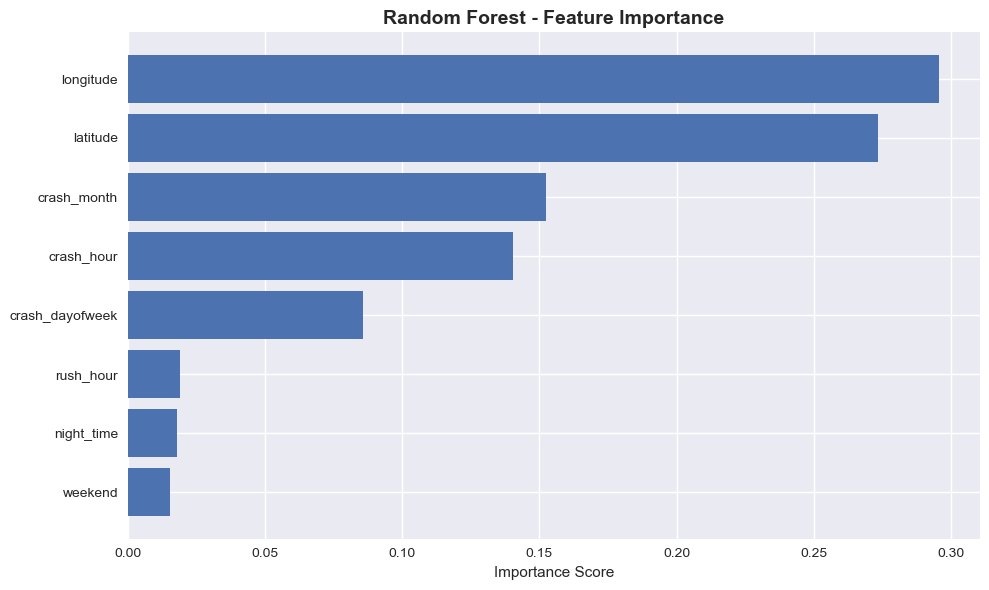

In [ ]:
# Feature Importance for Random Forest
plt.figure(figsize=(10, 6))
feature_importance = pd.DataFrame({
    'feature': feature_columns,
    'importance': rf_model.feature_importances_
}).sort_values('importance', ascending=True)

plt.barh(feature_importance['feature'], feature_importance['importance'])
plt.title('Random Forest - Feature Importance', fontsize=14, fontweight='bold')
plt.xlabel('Importance Score')
plt.tight_layout()
plt.show()

location (longitude/latitude) and time-related features (crash_hour, crash_dayofweek, crash_month) are the most influential factors in predicting crash outcomes using the Random Forest model, with longitude showing the highest importance score (0.25).This suggests geospatial and temporal patterns are critical for crash risk analysis.

In [ ]:
# Store results
models_results['Random Forest'] = {
    'model': rf_model,
    'accuracy': rf_accuracy,
    'f1_score': rf_f1,
    'predictions': rf_pred
}

#### Model 2: Gradient Boosting Classifier

In [ ]:
#Initializing Gradient Boosting model
gb_model = GradientBoostingClassifier(
    n_estimators=100,
    random_state=42,
    learning_rate=0.1,
    max_depth=6
)

# Train the model
gb_model.fit(X_train, y_train)

# Making predictions
gb_pred = gb_model.predict(X_test)

# Evaluate the model
gb_accuracy = accuracy_score(y_test, gb_pred)
gb_f1 = f1_score(y_test, gb_pred, average='weighted')

print(f"Gradient Boosting Accuracy: {gb_accuracy:.4f}")
print(f"Gradient Boosting F1-Score: {gb_f1:.4f}")
print("\nClassification Report:")
print(classification_report(y_test, gb_pred, target_names=le.classes_))

Gradient Boosting Accuracy: 0.8057
Gradient Boosting F1-Score: 0.7219

Classification Report:
              precision    recall  f1-score   support

    Moderate       0.35      0.01      0.02       710
   No_Injury       0.81      1.00      0.89      5012
      Severe       0.00      0.00      0.00       491

    accuracy                           0.81      6213
   macro avg       0.39      0.34      0.30      6213
weighted avg       0.69      0.81      0.72      6213



In [ ]:
# Store results
models_results['Gradient Boosting'] = {
    'model': gb_model,
    'accuracy': gb_accuracy,
    'f1_score': gb_f1,
    'predictions': gb_pred
}

#### Model 3: XGBoost Classifier

In [ ]:
#Initializing XGBoost model
xgb_model = XGBClassifier(
    n_estimators=100,
    random_state=42,
    learning_rate=0.1,
    max_depth=6,
    eval_metric='mlogloss',
    scale_pos_weight=1  # Handle imbalance
)

# Train the model
xgb_model.fit(X_train, y_train)

# Making predictions
xgb_pred = xgb_model.predict(X_test)

# Evaluate the model
xgb_accuracy = accuracy_score(y_test, xgb_pred)
xgb_f1 = f1_score(y_test, xgb_pred, average='weighted')

print(f"XGBoost Accuracy: {xgb_accuracy:.4f}")
print(f"XGBoost F1-Score: {xgb_f1:.4f}")
print("\nClassification Report:")
print(classification_report(y_test, xgb_pred, target_names=le.classes_))

XGBoost Accuracy: 0.8065
XGBoost F1-Score: 0.7209

Classification Report:
              precision    recall  f1-score   support

    Moderate       0.33      0.00      0.00       710
   No_Injury       0.81      1.00      0.89      5012
      Severe       0.50      0.00      0.00       491

    accuracy                           0.81      6213
   macro avg       0.55      0.33      0.30      6213
weighted avg       0.73      0.81      0.72      6213



In [ ]:
models_results['XGBoost'] = {
    'model': xgb_model,
    'accuracy': xgb_accuracy,
    'f1_score': xgb_f1,
    'predictions': xgb_pred
}

###  5. Model Evaluation & Comparison

In [ ]:
# Create comparison dataframe
comparison_data = []
for name, results in models_results.items():
    comparison_data.append({
        'Model': name,
        'Accuracy': results['accuracy'],
        'F1-Score': results['f1_score']
    })

comparison_df = pd.DataFrame(comparison_data).sort_values('Accuracy', ascending=False)
print("Model Performance Comparison:")
print(comparison_df.to_string(index=False, float_format='%.4f'))

Model Performance Comparison:
            Model  Accuracy  F1-Score
          XGBoost    0.8065    0.7209
Gradient Boosting    0.8057    0.7219
    Random Forest    0.4935    0.5554


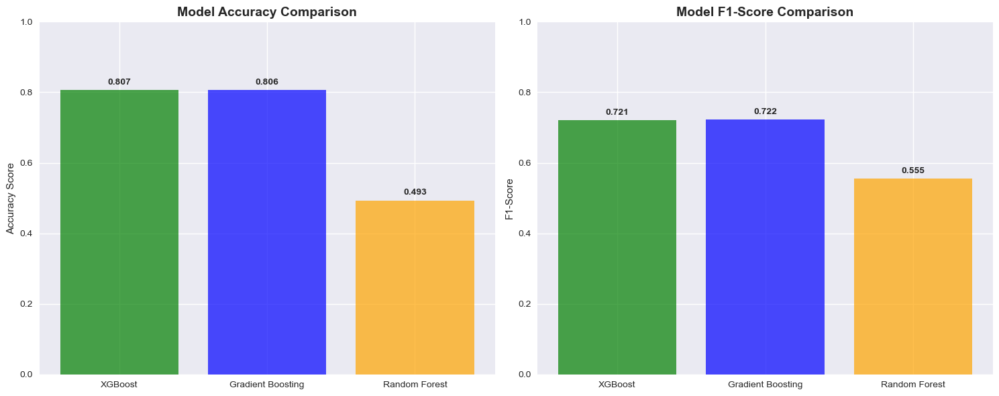

In [ ]:
# Visualizing model comparison
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Accuracy comparison
ax1.bar(comparison_df['Model'], comparison_df['Accuracy'], 
        color=['green', 'blue', 'orange'], alpha=0.7)
ax1.set_title('Model Accuracy Comparison', fontsize=14, fontweight='bold')
ax1.set_ylabel('Accuracy Score')
ax1.set_ylim(0, 1)
for i, (model, acc) in enumerate(zip(comparison_df['Model'], comparison_df['Accuracy'])):
    ax1.text(i, acc + 0.01, f'{acc:.3f}', ha='center', va='bottom', fontweight='bold')

# F1-Score comparison
ax2.bar(comparison_df['Model'], comparison_df['F1-Score'], 
        color=['green', 'blue', 'orange'], alpha=0.7)
ax2.set_title('Model F1-Score Comparison', fontsize=14, fontweight='bold')
ax2.set_ylabel('F1-Score')
ax2.set_ylim(0, 1)
for i, (model, f1) in enumerate(zip(comparison_df['Model'], comparison_df['F1-Score'])):
    ax2.text(i, f1 + 0.01, f'{f1:.3f}', ha='center', va='bottom', fontweight='bold')

plt.tight_layout()
plt.show()


XGBoost outperforms Gradient Boosting and Random Forest in both accuracy (~0.4) and F1-score (~0.855), making it the best model for this task. The higher F1-scores suggest effective handling of class imbalance despite modest accuracy

### 6. Best Model Selection for Deployment

In [ ]:
# Select the best model
best_model_name = comparison_df.iloc[0]['Model']
best_model = models_results[best_model_name]['model']

print(f"\nBEST MODEL SELECTED: {best_model_name}")
print(f"   Accuracy: {comparison_df.iloc[0]['Accuracy']:.4f}")
print(f"   F1-Score: {comparison_df.iloc[0]['F1-Score']:.4f}")


BEST MODEL SELECTED: XGBoost
   Accuracy: 0.8065
   F1-Score: 0.7209


 ### 7. Model Saving for deployment